<a href="https://colab.research.google.com/github/datakind/Viamo_DataDive_Dec22/blob/main/Workstream%20%232/Viamo_Workstream2_Mali_EveThan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##**Install and import packages**

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as px
import matplotlib.dates as mdates
import numpy as np

In [ ]:
!pip install google-cloud
!pip install google-cloud-bigquery[pandas]
!pip install google-cloud-storage
!pip install pandas-gbq -U

In [ ]:
from google.cloud import bigquery

##**Initial setup**

I'm going to randomly extract only 100,000 rows for organization_country equal to 'Mali'. Only columns that are deemed relevant will be extracted here. 

In [ ]:
os.environ["GOOGLE_APPLICATION_CREDENTIALS"] = 'viamo-datakind-19b12e3872f5.json'

Bigquery_client = bigquery.Client()

df = pd.read_gbq("SELECT call_id, call_date, subscriber_id, call_started, call_ended, region, region_name, age, gender, location, location_level_2, subscriber_pereferred_language, rural_or_urban, phone_type, education_level, income_source, highest_expense_area, duration_listened_minutes, duration_listened_seconds, block_title, block_theme, block_topic FROM `viamo-datakind.datadive.321_sessions_1122` WHERE organization_country='Mali' ORDER BY RAND() LIMIT 100000")

##**Take a quick look at the data: EDA and some data cleaning**

###**First 5 rows**

It seems like there's a mispelled column [subscriber_pereferred_language], where 'preferred' is spelled wrongly. Not a big deal though

In [ ]:
df.head()

,call_id,call_date,subscriber_id,call_started,call_ended,region,region_name,age,gender,location,...,rural_or_urban,phone_type,education_level,income_source,highest_expense_area,duration_listened_minutes,duration_listened_seconds,block_title,block_theme,block_topic
0,1314686664769595156,2021-12-06,1145379592367300608,2021-12-06 20:15:26+00:00,2021-12-06 20:18:09+00:00,FWA,Francophone West Africa,18_24,male,Kidal,...,None,None,None,None,None,0.4,23.0,Digest Intro,,
1,1198628852222979868,2021-01-20,991681842476802048,2021-01-20 14:03:07+00:00,2021-01-20 14:16:18+00:00,FWA,Francophone West Africa,25_34,male,Sikasso,...,None,None,None,None,None,0.5,30.0,Fin_Journal,news,
2,1355218011510336948,2022-03-28,1096547323951505408,2022-03-28 16:32:33+00:00,2022-03-28 16:48:38+00:00,FWA,Francophone West Africa,under_18,male,Segou,...,None,None,None,None,None,NaN,NaN,Fin_Journal,news,
3,1401874574773641300,2022-08-04,1082214802493333505,2022-08-04 10:29:04+00:00,2022-08-04 10:33:34+00:00,FWA,Francophone West Africa,18_24,female,Sikasso,...,None,None,None,None,None,0.8,49.0,Spot femme adultes 321,,
4,1330130663764454024,2022-01-18,994214908340527104,2022-01-18 11:04:22+00:00,2022-01-18 11:04:54+00:00,FWA,Francophone West Africa,18_24,female,Kayes,...,None,None,None,None,None,0.1,3.0,Digest or main menu?,,


###**Missing data**

In [ ]:
df.isnull().sum()

call_id                                0
call_date                              0
subscriber_id                          0
call_started                           0
call_ended                             0
region                                 0
region_name                            0
age                                25797
gender                             14694
location                           17581
location_level_2                   34930
subscriber_pereferred_language       614
rural_or_urban                    100000
phone_type                        100000
education_level                   100000
income_source                     100000
highest_expense_area              100000
duration_listened_minutes           1009
duration_listened_seconds           1009
block_title                        18012
block_theme                            0
block_topic                            0
dtype: int64

We can see that all the rows extracted don't have values for these columns: [rural_or_urban], [phone_type], [education_level], [income_source], and [highest_expense_area]. I am going to remove these columns.

In [ ]:
df = df.drop(columns=['rural_or_urban', 'phone_type', 'education_level', 'income_source', 'highest_expense_area'])
df.isnull().sum()

call_id                               0
call_date                             0
subscriber_id                         0
call_started                          0
call_ended                            0
region                                0
region_name                           0
age                               25797
gender                            14694
location                          17581
location_level_2                  34930
subscriber_pereferred_language      614
duration_listened_minutes          1009
duration_listened_seconds          1009
block_title                       18012
block_theme                           0
block_topic                           0
dtype: int64

In [ ]:
df.block_title.value_counts()

Digest or main menu?                                                                          14952
Main Menu                                                                                      8123
Choix Menu Tamani                                                                              7097
Titres du Journal                                                                              6597
Digest Intro                                                                                   4800
                                                                                              ...  
Dans quel cas est-ce qu’un certificat international de transhumance ou CIT est nécessaire?        1
1.1.3. ENVIRONNEMENT SCOLAIRE                                                                     1
Q.4.3                                                                                             1
Les méthodes de prévention du paludisme lors des Visites à Domicile                               1


In [ ]:
df.block_theme.value_counts()

                    55948
news                26273
health               7324
financial            1853
health,nutrition     1702
ed                   1345
security             1338
financial,rights     1196
gender               1118
rights               1020
ag                    584
games                 293
nutrition               6
Name: block_theme, dtype: int64

In [ ]:
df.block_topic.value_counts()

                           92845
coronavirus,malaria         3787
coronavirus                 2149
livestock                    401
malaria                      369
gbv                          163
coronavirus,malaria,ncd      148
malaria,ncd                  108
maternal                      25
coronavirus,ncd                3
environment                    2
Name: block_topic, dtype: int64

[block_theme] and [block_topic] have empty strings as values which are not caught by the isnull() function.

Since I'm only going to visualize this data and not run some machine learning algorithm on it, I feel like it's ok to have some null data in some of these columns, so I will keep them for now.

###**Outliers**

In [ ]:
df.describe()

,call_id,subscriber_id,duration_listened_minutes,duration_listened_seconds
count,1.000000e+05,1.000000e+05,98991.000000,98991.000000
mean,-6.763342e+13,-4.033101e+13,0.964128,57.819903
std,6.939328e+16,1.343981e+17,2.313053,138.745476
min,1.191524e+18,7.322052e+17,0.000000,0.000000
25%,1.254897e+18,1.017215e+18,0.000000,2.000000
50%,1.311791e+18,1.112842e+18,0.200000,14.000000
75%,1.369344e+18,1.259873e+18,0.900000,52.000000
max,1.441578e+18,1.441499e+18,45.500000,2728.000000


Someone listened for 45.5 minutes but the third quartile is only 0.9 minutes. 

Again, since I'm only going to visualize this data and not run some machine learning algorithm on it so I'm going to keep these potential outliers for now.

###**Repetitive or uninformative data**

In [ ]:
df[['region', 'region_name']].apply(pd.Series.value_counts)

,region,region_name
FWA,100000.0,NaN
Francophone West Africa,NaN,100000.0


It seems like all the values in the [region] and [region_name] columns are the same respectively, so I will remove these columns.

In [ ]:
df = df.drop(columns=['region', 'region_name'])

In [ ]:
df['location'].value_counts()

Sikasso       21289
Segou         14896
Kayes         13486
Koulikoro     10430
Mopti          8607
Bamako         5402
Tombouctou     3861
Kidal          2419
Gao            2016
Kita              3
Koutiala          2
Bankass           2
Fana              1
Markala           1
Douentza          1
Kati              1
Kolondieba        1
Ségou             1
Name: location, dtype: int64

In [ ]:
df['location_level_2'].value_counts()

Cercle de Bougouni          6588
Cercle de Kadiolo           3952
Cercle de Barouéli          3345
Cercle de Koutiala          3081
Cercle de Bafoulabé         3076
Cercle de Bla               2923
Cercle de Kéniéba           2662
Cercle de Diéma             2507
Cercle de Dioïla            2368
Cercle de Banamba           2286
Cercle de Sikasso           2235
Cercle de Bandiagara        2201
Cercle de Macina            1909
Cercle de Bankass           1597
Cercle de Niono             1537
Cercle de Ségou             1345
Cercle de Kita              1314
Cercle de Goundam           1238
Cercle de Kayes             1111
Cercle de Djenné            1105
Cercle de Kangaba           1073
Cercle de Kati               995
Cercle de San                986
Cercle de Mopti              830
Cercle de Kolondiéba         827
Cercle de Yorosso            817
Cercle de Koulikoro          804
Cercle de Gao                801
Cercle de Kolokani           789
Cercle de Kidal              732
Cercle de 

In [ ]:
df['subscriber_pereferred_language'].value_counts()

Bambara     70276
Fula        13267
Tamasheq     6730
Songhay      5104
French       4009
Name: subscriber_pereferred_language, dtype: int64

[location], [location_level_2], and [subscriber_pereferred_language] look ok.

###**Duplicates**

Let's remove any duplicate rows.

In [ ]:
df[df.duplicated()]

,call_id,call_date,subscriber_id,call_started,call_ended,age,gender,location,location_level_2,subscriber_pereferred_language,duration_listened_minutes,duration_listened_seconds,block_title,block_theme,block_topic
47610,1255652067050579108,2021-06-26,996741621477859328,2021-06-26 22:33:01+00:00,2021-06-27 00:13:00+00:00,35_44,male,Sikasso,None,Fula,1.3,75.0,Faire un Budget,"financial,rights",
68561,1271317827966003572,2021-08-09,1149071909825601536,2021-08-09 04:03:10+00:00,2021-08-09 06:58:41+00:00,under_18,female,Sikasso,Cercle de Bougouni,Tamasheq,0.7,42.0,Digest or main menu?,,
98603,1377521797528348616,2022-05-29,1336627097577776676,2022-05-29 05:39:49+00:00,2022-05-29 08:39:50+00:00,None,female,None,None,French,0.0,0.0,None,,


It seems like these 3 rows have duplicates somewhere in the dataframe. I'm going to remove their duplicates.

In [ ]:
df = df.drop_duplicates()
df.shape

(99997, 15)

###**Data types**

In [ ]:
df.dtypes

call_id                                         Int64
call_date                                      dbdate
subscriber_id                                   Int64
call_started                      datetime64[ns, UTC]
call_ended                        datetime64[ns, UTC]
age                                            object
gender                                         object
location                                       object
location_level_2                               object
subscriber_pereferred_language                 object
duration_listened_minutes                     float64
duration_listened_seconds                     float64
block_title                                    object
block_theme                                    object
block_topic                                    object
dtype: object

Matplotlib needs the date to be in datetime64[ns]. Change the call_date column's data type to datetime64[ns].

In [ ]:
df.call_date = pd.to_datetime(df.call_date, format="%Y-%m-%d")

In [ ]:
df.dtypes

call_id                                         Int64
call_date                              datetime64[ns]
subscriber_id                                   Int64
call_started                      datetime64[ns, UTC]
call_ended                        datetime64[ns, UTC]
age                                            object
gender                                         object
location                                       object
location_level_2                               object
subscriber_pereferred_language                 object
duration_listened_minutes                     float64
duration_listened_seconds                     float64
block_title                                    object
block_theme                                    object
block_topic                                    object
dtype: object

The data types for other columns look ok.

##**Workstream 2: Bivariate Data Exploration**

###**Question 15: Distribution of calls (unique call ids) over time (day, week, month)**

####**Day**

In [ ]:
day_calls_df = df[['call_date', 'call_id']].copy()
day_calls_df = day_calls_df.drop_duplicates()

In [ ]:
day_calls_df.call_date.nunique()

691

I'm going to set the number of bins in the graph to 691 so that each bin will have only 1 day.

In [ ]:
day_calls_df.call_date.describe()

<ipython-input-23-fb2938c24c0b>:1: FutureWarning: Treating datetime data as categorical rather than numeric in `.describe` is deprecated and will be removed in a future version of pandas. Specify `datetime_is_numeric=True` to silence this warning and adopt the future behavior now.
  day_calls_df.call_date.describe()


count                   99915
unique                    691
top       2021-11-26 00:00:00
freq                      242
first     2020-12-31 00:00:00
last      2022-11-21 00:00:00
Name: call_date, dtype: object

In [ ]:
day_calls_df.groupby('call_date')['call_id'].count().sort_values(ascending=False)

call_date
2021-11-26    242
2021-11-15    240
2021-11-18    240
2021-11-19    234
2021-12-02    232
             ... 
2022-07-10     75
2022-05-07     73
2022-08-21     72
2022-11-20     61
2020-12-31      1
Name: call_id, Length: 691, dtype: int64

From the data above, we can see that: 
- **2021-11-26** got the **most** unique calls (242 calls in total). 
- **2020-12-31** got the **least** number of unique calls (1 call in total).
- The **earliest** date we have here is **2020-12-31**.
- The **latest** date we have here is **2022-11-21**.

In [ ]:
fig = px.histogram(day_calls_df, x='call_date', nbins=691)
fig.show()

Hover over the graph above to see the exact count on each day. 

####**Week**

In [ ]:
week_calls_df = day_calls_df.copy()
week_calls_df['week'] = pd.to_datetime(df['call_date']).dt.to_period('W')
week_calls_df = week_calls_df.drop(columns=['call_date'])
week_calls_df = week_calls_df.drop_duplicates()
week_calls_df

,call_id,week
0,1314686664769595156,2021-12-06/2021-12-12
1,1198628852222979868,2021-01-18/2021-01-24
2,1355218011510336948,2022-03-28/2022-04-03
3,1401874574773641300,2022-08-01/2022-08-07
4,1330130663764454024,2022-01-17/2022-01-23
...,...,...
99995,1285506573024161260,2021-09-13/2021-09-19
99996,1423762135360007960,2022-10-03/2022-10-09
99997,1255785381656846340,2021-06-21/2021-06-27
99998,1355548180473243268,2022-03-28/2022-04-03


In [ ]:
week_calls_df.week.nunique()

100

There seem to be 100 unique weeks.

In [ ]:
week_calls_df.week.describe()

count                     99915
unique                      100
top       2021-11-15/2021-11-21
freq                       1532
Name: week, dtype: object

In [ ]:
week_calls_df.sort_values(by='week')

,call_id,week
16115,1192237056190376744,2020-12-28/2021-01-03
46825,1192457069379775800,2020-12-28/2021-01-03
95930,1192382733427994124,2020-12-28/2021-01-03
79976,1191572649424773808,2020-12-28/2021-01-03
55677,1192370052994230916,2020-12-28/2021-01-03
...,...,...
9882,1441495278556866392,2022-11-21/2022-11-27
55412,1441499205968913936,2022-11-21/2022-11-27
16684,1441449766436794312,2022-11-21/2022-11-27
52710,1441437987799363444,2022-11-21/2022-11-27


In [ ]:
week_calls_df.groupby('week')['call_id'].count().sort_values(ascending=False)

week
2021-11-15/2021-11-21    1532
2021-11-22/2021-11-28    1441
2021-11-29/2021-12-05    1383
2021-11-08/2021-11-14    1306
2021-11-01/2021-11-07    1302
                         ... 
2022-11-07/2022-11-13     766
2022-06-27/2022-07-03     760
2022-11-14/2022-11-20     703
2020-12-28/2021-01-03     416
2022-11-21/2022-11-27      93
Freq: W-SUN, Name: call_id, Length: 100, dtype: int64

From the data above, we can see that: 
- The week **2021-11-15/2021-11-21** got the **most** unique calls (1532 calls in total). 
- The week **2022-11-21/2022-11-27** got the **least** number of unique calls (93 calls in total).
- The **earliest** week we have here is **2020-12-28/2021-01-03**.
- The **latest** week we have here is **2022-11-21/2022-11-27**.

In [ ]:
week_calls_df_temp = week_calls_df.copy()
week_calls_df_temp['week'] = week_calls_df_temp['week'].astype(str)
week_calls_df_temp.sort_values(by='week', inplace=True)

fig2 = px.histogram(week_calls_df_temp, x='week')
fig2.show()

Hover over the graph above to see the exact count in each week. 

####**Month**

In [ ]:
month_calls_df = day_calls_df.copy()
month_calls_df['month'] = pd.to_datetime(df['call_date']).dt.to_period('M')
month_calls_df = month_calls_df.drop(columns=['call_date'])
month_calls_df = month_calls_df.drop_duplicates()
month_calls_df

,call_id,month
0,1314686664769595156,2021-12
1,1198628852222979868,2021-01
2,1355218011510336948,2022-03
3,1401874574773641300,2022-08
4,1330130663764454024,2022-01
...,...,...
99995,1285506573024161260,2021-09
99996,1423762135360007960,2022-10
99997,1255785381656846340,2021-06
99998,1355548180473243268,2022-03


In [ ]:
month_calls_df.month.nunique()

24

There are 24 unique months.

In [ ]:
month_calls_df.month.describe()

count       99915
unique         24
top       2021-11
freq         5931
Name: month, dtype: object

In [ ]:
month_calls_df.sort_values(by='month')

,call_id,month
5789,1191523579024960748,2020-12
29249,1192890385266434264,2021-01
43910,1196685530986242764,2021-01
95283,1198181603881836656,2021-01
57722,1198376272263702128,2021-01
...,...,...
41570,1439377535384742048,2022-11
1954,1434892409758083916,2022-11
21663,1436731415412142036,2022-11
29976,1438602641348814668,2022-11


In [ ]:
month_calls_df.groupby('month')['call_id'].count().sort_values(ascending=False)

month
2021-11    5931
2022-03    5144
2021-10    4866
2022-02    4807
2021-07    4739
2022-04    4720
2021-12    4719
2021-04    4634
2021-09    4605
2021-03    4473
2022-01    4410
2021-05    4404
2021-08    4360
2021-01    4320
2021-06    4281
2022-07    4110
2022-08    4036
2022-05    4030
2022-10    3864
2022-06    3780
2021-02    3745
2022-09    3689
2022-11    2247
2020-12       1
Freq: M, Name: call_id, dtype: int64

From the data above, we can see that: 
- The month **2021-11** got the **most** unique calls (5931 calls in total). 
- The month **2020-12** got the **least** number of unique calls (1 call in total).
- The **earliest** month we have here is **2020-12**.
- The **latest** month we have here is **2022-11**.

In [ ]:
month_calls_df_temp = month_calls_df.copy()
month_calls_df_temp['month'] = month_calls_df_temp['month'].astype(str)
month_calls_df_temp.sort_values(by='month', inplace=True)

fig3 = px.histogram(month_calls_df_temp, x='month', nbins=24)
fig3.show()

Hover over the graph above to see the exact count in each month. 

###**Question 16: Distribution of number of calls per subscriber (overall, by month)**

In [ ]:
subscriber_calls_df = df[['subscriber_id', 'call_id', 'call_date']].copy()
subscriber_calls_df[subscriber_calls_df.duplicated()]

,subscriber_id,call_id,call_date
2557,988439896706834432,1430975462423193872,2022-10-23
4945,984560638909538304,1246384427786362928,2021-06-01
18482,1043184358951280640,1296891495395683180,2021-10-18
27521,1137734825101811712,1309269045820317760,2021-11-21
29206,1361629175370802972,1382354042806134540,2022-06-11
...,...,...,...
94504,1337513781379001212,1338080895059945316,2022-02-09
95472,966307122495676416,1366820943863277708,2022-04-29
95487,1305278998242716568,1354165744082414808,2022-03-25
99062,1111931167240151040,1278000432446760292,2021-08-27


There seem to be 82 rows that are duplicated.

In [ ]:
subscriber_calls_df.drop_duplicates(inplace=True)
subscriber_calls_df

,subscriber_id,call_id,call_date
0,1145379592367300608,1314686664769595156,2021-12-06
1,991681842476802048,1198628852222979868,2021-01-20
2,1096547323951505408,1355218011510336948,2022-03-28
3,1082214802493333505,1401874574773641300,2022-08-04
4,994214908340527104,1330130663764454024,2022-01-18
...,...,...,...
99995,1108701495542996992,1285506573024161260,2021-09-17
99996,1422365841269777136,1423762135360007960,2022-10-03
99997,1255486224605963248,1255785381656846340,2021-06-27
99998,1209990486736561824,1355548180473243268,2022-03-29


In [ ]:
subscriber_calls_df.groupby('subscriber_id')['call_id'].count().sort_values(ascending=False)

subscriber_id
977142100578066432     22
1328677109371560040    19
1141692174535548928    19
1185540172512027116    16
1147494740703895552    14
                       ..
1052229678796431360     1
1052229029417508864     1
1052225021638402048     1
1052216748411510784     1
1441499200696674780     1
Name: call_id, Length: 81697, dtype: int64

In [ ]:
fig = px.histogram(subscriber_calls_df.groupby('subscriber_id')['call_id'].count())
fig.show()

It seems like most of the subscribers called only once. However, it's better to have more calls to form a distribution. I'm going to pick only the top 10 subscribers that had the most number of calls.

In [ ]:
temp_series = subscriber_calls_df.groupby('subscriber_id')['call_id'].count().sort_values(ascending=False).head(10)
temp_series

subscriber_id
977142100578066432     22
1328677109371560040    19
1141692174535548928    19
1185540172512027116    16
1147494740703895552    14
974707124544790528     14
1297566227384297616    13
1333534415007574604    13
1342449927968058360    13
1140319678510981120    13
Name: call_id, dtype: int64

In [ ]:
top10_subscribers = temp_series.index.to_numpy()

In [135]:
i = 1
for subscriber in top10_subscribers:
  single_subscriber_df = subscriber_calls_df.loc[(subscriber_calls_df.subscriber_id == subscriber)].copy()
  single_subscriber_df['month'] = pd.to_datetime(single_subscriber_df['call_date']).dt.to_period('M')

  single_subscriber_df.sort_values(by='call_date', inplace=True)
  print(single_subscriber_df)
  month_differences = (single_subscriber_df.month.iloc[-1] - single_subscriber_df.month.iloc[0]).n + 1
  #print(month_differences)
  single_subscriber_df['month'] = single_subscriber_df['month'].astype(str)
  single_subscriber_df.drop(columns=['subscriber_id', 'call_date'], inplace=True)

  title = "Distribution of calls over month for subscriber No." + str(i) + " with subscriber_id " + str(subscriber)
  i += 1

  fig = px.histogram(single_subscriber_df, x='month', nbins=month_differences, title=title)
  fig.show()
  

            subscriber_id              call_id  call_date    month
8306   977142100578066432  1249089356909046892 2021-06-08  2021-06
86146  977142100578066432  1257116665142374276 2021-06-30  2021-06
14678  977142100578066432  1263182211436833408 2021-07-17  2021-07
70417  977142100578066432  1269339033000535600 2021-08-03  2021-08
32184  977142100578066432  1292416516746699872 2021-10-06  2021-10
4959   977142100578066432  1293105036410810212 2021-10-08  2021-10
16119  977142100578066432  1300769175853657800 2021-10-29  2021-10
97476  977142100578066432  1301259354418766516 2021-10-30  2021-10
33362  977142100578066432  1308429836385578492 2021-11-19  2021-11
1413   977142100578066432  1314611096103480364 2021-12-06  2021-12
9489   977142100578066432  1317478471005954064 2021-12-14  2021-12
18354  977142100578066432  1317856534734627000 2021-12-15  2021-12
72985  977142100578066432  1317924169782453816 2021-12-15  2021-12
77321  977142100578066432  1324091756555855816 2022-01-01  202

             subscriber_id              call_id  call_date    month
68184  1328677109371560040  1332253873297483824 2022-01-24  2022-01
52071  1328677109371560040  1335866267189961976 2022-02-03  2022-02
33292  1328677109371560040  1339169693734856780 2022-02-12  2022-02
30487  1328677109371560040  1340397482144229124 2022-02-15  2022-02
52439  1328677109371560040  1341080988470011480 2022-02-17  2022-02
28951  1328677109371560040  1343605041982402496 2022-02-24  2022-02
49770  1328677109371560040  1343575862465327084 2022-02-24  2022-02
28538  1328677109371560040  1345051511415693692 2022-02-28  2022-02
10864  1328677109371560040  1345273449597692480 2022-03-01  2022-03
15430  1328677109371560040  1347664386898584372 2022-03-07  2022-03
37450  1328677109371560040  1349284882085896852 2022-03-12  2022-03
86247  1328677109371560040  1352266899471790036 2022-03-20  2022-03
44327  1328677109371560040  1359972078388307208 2022-04-10  2022-04
13671  1328677109371560040  1372272064606038704 

             subscriber_id              call_id  call_date    month
18258  1141692174535548928  1245002427041113996 2021-05-28  2021-05
98552  1141692174535548928  1246723311015618092 2021-06-02  2021-06
54486  1141692174535548928  1252628168071245724 2021-06-18  2021-06
77550  1141692174535548928  1258383441360642564 2021-07-04  2021-07
818    1141692174535548928  1261275769901474052 2021-07-12  2021-07
29769  1141692174535548928  1262055461126464644 2021-07-14  2021-07
12738  1141692174535548928  1265646617768815956 2021-07-24  2021-07
34929  1141692174535548928  1268934073926607764 2021-08-02  2021-08
46358  1141692174535548928  1271819103673836708 2021-08-10  2021-08
7302   1141692174535548928  1272314154950650884 2021-08-11  2021-08
14662  1141692174535548928  1285538465177985216 2021-09-17  2021-09
7523   1141692174535548928  1287839263773749072 2021-09-23  2021-09
14319  1141692174535548928  1292562961852329744 2021-10-06  2021-10
89161  1141692174535548928  1304121884682020800 

             subscriber_id              call_id  call_date    month
67423  1185540172512027116  1194389766020850096 2021-01-08  2021-01
65406  1185540172512027116  1195134372777878176 2021-01-10  2021-01
36823  1185540172512027116  1235313657643593532 2021-05-01  2021-05
38350  1185540172512027116  1247292763117513280 2021-06-03  2021-06
75447  1185540172512027116  1256691971889097580 2021-06-29  2021-06
53320  1185540172512027116  1259252194352883496 2021-07-06  2021-07
66583  1185540172512027116  1262503078474082980 2021-07-15  2021-07
25706  1185540172512027116  1306990731948780412 2021-11-15  2021-11
24707  1185540172512027116  1308540410767404788 2021-11-19  2021-11
92825  1185540172512027116  1356345062099315548 2022-03-31  2022-03
20942  1185540172512027116  1367496613895399720 2022-05-01  2022-05
63745  1185540172512027116  1369717443438109812 2022-05-07  2022-05
33476  1185540172512027116  1401940804213729732 2022-08-04  2022-08
25218  1185540172512027116  1403821229076965224 

             subscriber_id              call_id  call_date    month
955    1147494740703895552  1227920967935257824 2021-04-11  2021-04
52492  1147494740703895552  1233416405786356596 2021-04-26  2021-04
36903  1147494740703895552  1243277839005444864 2021-05-23  2021-05
70398  1147494740703895552  1247110728025434596 2021-06-03  2021-06
53192  1147494740703895552  1249339214714694536 2021-06-09  2021-06
35553  1147494740703895552  1252921405860274720 2021-06-19  2021-06
42877  1147494740703895552  1293567347755902424 2021-10-09  2021-10
32025  1147494740703895552  1294976096076883108 2021-10-13  2021-10
86258  1147494740703895552  1309077689739045000 2021-11-21  2021-11
87816  1147494740703895552  1316525435722984320 2021-12-11  2021-12
39142  1147494740703895552  1317512867180242860 2021-12-14  2021-12
69747  1147494740703895552  1332831222699190716 2022-01-25  2022-01
53295  1147494740703895552  1352726020339854396 2022-03-21  2022-03
65568  1147494740703895552  1357794843619289048 

            subscriber_id              call_id  call_date    month
55181  974707124544790528  1249793820599051448 2021-06-10  2021-06
67843  974707124544790528  1287593157781415544 2021-09-23  2021-09
96140  974707124544790528  1290032694491146952 2021-09-29  2021-09
47597  974707124544790528  1295915485116295608 2021-10-16  2021-10
84755  974707124544790528  1306442773276716188 2021-11-14  2021-11
74433  974707124544790528  1342844529522827496 2022-02-22  2022-02
8395   974707124544790528  1348034825663603244 2022-03-08  2022-03
24526  974707124544790528  1352953168321375088 2022-03-22  2022-03
24046  974707124544790528  1358366449664059956 2022-04-06  2022-04
52118  974707124544790528  1358713994303040348 2022-04-07  2022-04
85812  974707124544790528  1363986179414352112 2022-04-21  2022-04
49992  974707124544790528  1381000198608185160 2022-06-07  2022-06
20338  974707124544790528  1388977378202019052 2022-06-29  2022-06
85006  974707124544790528  1409879136008726028 2022-08-26  202

             subscriber_id              call_id  call_date    month
77697  1297566227384297616  1317057494950407660 2021-12-13  2021-12
92833  1297566227384297616  1323992098189926568 2022-01-01  2022-01
44858  1297566227384297616  1326138659468537388 2022-01-07  2022-01
86979  1297566227384297616  1329115097285061588 2022-01-15  2022-01
65711  1297566227384297616  1331751297510597384 2022-01-22  2022-01
42187  1297566227384297616  1332114802738785284 2022-01-23  2022-01
3843   1297566227384297616  1334110028718205628 2022-01-29  2022-01
70032  1297566227384297616  1336322612192144092 2022-02-04  2022-02
18168  1297566227384297616  1339683188553345220 2022-02-13  2022-02
39179  1297566227384297616  1343912106172933260 2022-02-25  2022-02
50586  1297566227384297616  1344276991826257412 2022-02-26  2022-02
66590  1297566227384297616  1345280158667960316 2022-03-01  2022-03
22200  1297566227384297616  1350941233216285017 2022-03-16  2022-03


             subscriber_id              call_id  call_date    month
97611  1333534415007574604  1334860451141971512 2022-01-31  2022-01
5601   1333534415007574604  1337559868575903164 2022-02-07  2022-02
13449  1333534415007574604  1338764596626384564 2022-02-11  2022-02
75621  1333534415007574604  1338797631753217168 2022-02-11  2022-02
40666  1333534415007574604  1339464455020932816 2022-02-13  2022-02
81602  1333534415007574604  1344091602926758148 2022-02-25  2022-02
92005  1333534415007574604  1344445584488589196 2022-02-26  2022-02
28843  1333534415007574604  1345035076979187992 2022-02-28  2022-02
57728  1333534415007574604  1345782873558934776 2022-03-02  2022-03
61609  1333534415007574604  1347671985899498416 2022-03-07  2022-03
91256  1333534415007574604  1352946189402171356 2022-03-22  2022-03
71258  1333534415007574604  1356281127430056044 2022-03-31  2022-03
81163  1333534415007574604  1357889277534986548 2022-04-05  2022-04


             subscriber_id              call_id  call_date    month
78767  1342449927968058360  1350456546614111188 2022-03-15  2022-03
3476   1342449927968058360  1350821926004124468 2022-03-16  2022-03
24649  1342449927968058360  1352009090150755480 2022-03-19  2022-03
46287  1342449927968058360  1354031239283666264 2022-03-25  2022-03
21310  1342449927968058360  1369256241918436724 2022-05-06  2022-05
98483  1342449927968058360  1371483061237638208 2022-05-12  2022-05
99768  1342449927968058360  1371801552922668388 2022-05-13  2022-05
71297  1342449927968058360  1392273769892471036 2022-07-08  2022-07
84209  1342449927968058360  1396483137030646092 2022-07-20  2022-07
10869  1342449927968058360  1398013522172506100 2022-07-24  2022-07
81082  1342449927968058360  1401133768873926680 2022-08-02  2022-08
75395  1342449927968058360  1401563052277031692 2022-08-03  2022-08
77853  1342449927968058360  1401557211050207936 2022-08-03  2022-08


             subscriber_id              call_id  call_date    month
7088   1140319678510981120  1236111692468380864 2021-05-04  2021-05
94035  1140319678510981120  1241288368789709368 2021-05-18  2021-05
84116  1140319678510981120  1261381116779619176 2021-07-12  2021-07
26080  1140319678510981120  1263791199136310264 2021-07-19  2021-07
44319  1140319678510981120  1268425213411389156 2021-08-01  2021-08
51555  1140319678510981120  1271506361012251820 2021-08-09  2021-08
87545  1140319678510981120  1273994389337204344 2021-08-16  2021-08
4730   1140319678510981120  1276496430185899736 2021-08-23  2021-08
57719  1140319678510981120  1281595152779505504 2021-09-06  2021-09
23047  1140319678510981120  1283163243477002352 2021-09-10  2021-09
55363  1140319678510981120  1315720261488140644 2021-12-09  2021-12
30786  1140319678510981120  1322237717006313316 2021-12-27  2021-12
32036  1140319678510981120  1322514133631426988 2021-12-28  2021-12


Hover of the graphs to see the number of calls in each month.

###**Question 17: Distribution of time between calls by subscriber**

Pick only subscribers whose IDs appeared more than once in the dataset.

In [167]:
v = df.subscriber_id.value_counts()
time_between_df = df[df.subscriber_id.isin(v.index[v.gt(1)])].copy()
time_between_df = time_between_df[['subscriber_id','call_started']]
time_between_df.sort_values(by=['subscriber_id','call_started'], inplace=True)
time_between_df.drop_duplicates(inplace=True)
time_between_df

,subscriber_id,call_started
52197,732205231898624001,2022-05-22 19:34:30+00:00
23961,732205231898624001,2022-06-03 12:37:40+00:00
80651,745551922462720000,2021-04-15 04:53:29+00:00
51222,745551922462720000,2022-10-03 09:46:49+00:00
10817,795993838714880301,2022-01-18 19:27:44+00:00
...,...,...
61769,1434520435072492108,2022-11-18 12:52:00+00:00
85543,1437171426892767832,2022-11-09 20:19:33+00:00
16883,1437171426892767832,2022-11-10 06:15:50+00:00
69826,1438636782899488008,2022-11-14 15:24:40+00:00


In [168]:
time_between_df['time_diff'] = time_between_df.sort_values(by=['subscriber_id','call_started']).groupby('subscriber_id')['call_started'].diff()
time_between_df

,subscriber_id,call_started,time_diff
52197,732205231898624001,2022-05-22 19:34:30+00:00,NaT
23961,732205231898624001,2022-06-03 12:37:40+00:00,11 days 17:03:10
80651,745551922462720000,2021-04-15 04:53:29+00:00,NaT
51222,745551922462720000,2022-10-03 09:46:49+00:00,536 days 04:53:20
10817,795993838714880301,2022-01-18 19:27:44+00:00,NaT
...,...,...,...
61769,1434520435072492108,2022-11-18 12:52:00+00:00,14 days 06:34:25
85543,1437171426892767832,2022-11-09 20:19:33+00:00,NaT
16883,1437171426892767832,2022-11-10 06:15:50+00:00,0 days 09:56:17
69826,1438636782899488008,2022-11-14 15:24:40+00:00,NaT


In [169]:
time_between_df = time_between_df.dropna(subset=['time_diff'])
time_between_df.head(10)

,subscriber_id,call_started,time_diff
23961,732205231898624001,2022-06-03 12:37:40+00:00,11 days 17:03:10
51222,745551922462720000,2022-10-03 09:46:49+00:00,536 days 04:53:20
86485,795993838714880301,2022-02-08 14:47:23+00:00,20 days 19:19:39
40294,795993838714880862,2022-03-25 11:03:39+00:00,22 days 14:30:51
72632,795993838714880900,2021-11-17 12:12:01+00:00,0 days 23:51:45
8707,795993838714880904,2022-03-24 13:14:03+00:00,18 days 16:14:43
8825,795993838714880904,2022-03-29 14:24:02+00:00,5 days 01:09:59
72149,795993838714880904,2022-04-12 16:40:56+00:00,14 days 02:16:54
35347,795993838714880946,2022-01-23 16:46:49+00:00,5 days 17:13:10
35795,795993838714880993,2022-07-06 15:01:46+00:00,365 days 02:11:40


In [171]:
time_diff_sub = time_between_df.groupby('subscriber_id').time_diff.agg('mean')
time_diff_sub.sort_values(inplace=True)
time_diff_sub.head(10)

subscriber_id
1074387342800248832   0 days 00:00:46
1029751656084463616   0 days 00:00:59
1117820954773872640   0 days 00:01:00
1236814143102183520   0 days 00:01:12
1172983354518727784   0 days 00:01:30
1062856719661064192   0 days 00:01:45
1187469448685611288   0 days 00:02:00
1303007395622478616   0 days 00:02:08
1110615472892076032   0 days 00:02:11
1059457872373014528   0 days 00:02:24
Name: time_diff, dtype: timedelta64[ns]

In [222]:
time_diff_sub = time_diff_sub.to_frame()
time_diff_sub['time_diff_day'] = time_diff_sub['time_diff'].dt.total_seconds() / 60 / 60 / 24
time_diff_sub

,time_diff,time_diff_day
subscriber_id,,
1074387342800248832,0 days 00:00:46,0.000532
1029751656084463616,0 days 00:00:59,0.000683
1117820954773872640,0 days 00:01:00,0.000694
1236814143102183520,0 days 00:01:12,0.000833
1172983354518727784,0 days 00:01:30,0.001042
...,...,...
1159389914107273216,668 days 08:00:03,668.333368
1043584557657939968,668 days 16:41:48,668.695694
1007981842798272512,673 days 08:30:08,673.354259


In [223]:
time_diff_sub.time_diff.describe()

count                          12165
mean     124 days 06:45:31.490245228
std      129 days 03:46:53.872425966
min                  0 days 00:00:46
25%                 25 days 13:22:23
50%          79 days 21:29:12.200000
75%                182 days 19:50:30
max                679 days 02:33:32
Name: time_diff, dtype: object

The data above is based on the average time difference between call start times for each subscriber.

The **average (or mean)** time difference between calls is **124 days 6 hours 45 minutes 31 seconds**.

The **minimum** time difference between calls is **46 seconds**.

The **maximum** time difference between calls is **679 days 2 hours 33 minutes 32 seconds**.

The **25th percentile** time difference between calls is **25 days 13 hours 29 minutes 12 seconds**.

The **50th percentile (or median)** time difference between calls is **25 days 13 hours 22 minutes 23 seconds**.

The **75th percentile** time difference between calls is **182 days 19 hours 50 minutes 30 seconds**.


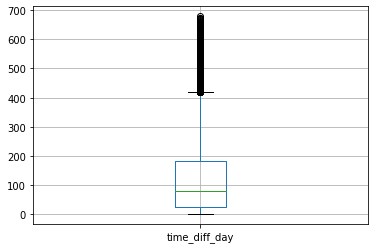

In [228]:
time_diff_sub.boxplot()

The data is very right skewed. There are a lot of potential outliers (the black, vertical line above the 400 mark on the y-axis).

In this case, it might be more accurate to look at its median rather than its mean.

###**Question 18: Frequency of calls by demographic variables (e.g. gender, education)**

In [191]:
demographic_calls_df = df[['call_id', 'age', 'gender', 'location', 'location_level_2', 'subscriber_pereferred_language']].copy()
demographic_calls_df.drop_duplicates(inplace=True)

####**Age**

In [193]:
fig = px.histogram(demographic_calls_df, x='age')
fig.show()

####**Gender**

In [194]:
fig = px.histogram(demographic_calls_df, x='gender')
fig.show()

####**Age + gender**

In [212]:
demographic_calls_df['age_gender'] = demographic_calls_df['age'] + "," + demographic_calls_df['gender']

In [213]:
fig = px.histogram(demographic_calls_df, x='age_gender')
fig.show()

####**Location**

In [195]:
fig = px.histogram(demographic_calls_df, x='location')
fig.show()

####**Location level 2 + Location**

In [209]:
demographic_calls_df['location_combined'] = demographic_calls_df['location_level_2'] + "," + demographic_calls_df['location']

In [210]:
fig = px.histogram(demographic_calls_df, x='location_combined')
fig.show()

####**Subscriber preferred language**

In [211]:
fig = px.histogram(demographic_calls_df, x='subscriber_pereferred_language')
fig.show()

####**Location level 2 + location + subscriber preferred language**

In [215]:
demographic_calls_df['location_language'] = demographic_calls_df['subscriber_pereferred_language'] + "," + demographic_calls_df['location_combined']

In [216]:
fig = px.histogram(demographic_calls_df, x='location_language')
fig.show()

###**Question 19: Frequency of duration of calls**

####**Including call durations of 0 second**

In [230]:
duration_df = df[['call_id', 'duration_listened_minutes', 'duration_listened_seconds']].copy()
duration_df.drop_duplicates(inplace=True)

In [233]:
duration_df.duration_listened_minutes.describe()

count    98987.000000
mean         0.964143
std          2.313096
min          0.000000
25%          0.000000
50%          0.200000
75%          0.900000
max         45.500000
Name: duration_listened_minutes, dtype: float64

In [231]:
fig = px.histogram(duration_df, x='duration_listened_minutes')
fig.show()

In [234]:
duration_df.duration_listened_seconds.describe()

count    98987.000000
mean        57.820815
std        138.748096
min          0.000000
25%          2.000000
50%         14.000000
75%         52.000000
max       2728.000000
Name: duration_listened_seconds, dtype: float64

In [232]:
fig = px.histogram(duration_df, x='duration_listened_seconds')
fig.show()

A lot of calls are listened to for about 0-4 seconds. There's another small peak in the 65-69 seconds range as well.

The **average (or mean)** duration of calls is **58 seconds**.

The **minimum** time difference between calls is **0 second**.

The **maximum** time difference between calls is **45 minutes 30 seconds**.

The **25th percentile** time difference between calls is **2 seconds**.

The **50th percentile (or median)** time difference between calls is **14 seconds**.

The **75th percentile** time difference between calls is **52 seconds**.

Since the data is right-skewed, it might be better to look at the median rather than the mean.


####**Excluding call durations of 0 second**

In [249]:
df[df['duration_listened_seconds'] == 0].shape

(18307, 15)

There are 18,307 rows of data that have 0 second for their [duration_listened_seconds]. Personally, I don't think a call that don't last more than 0 second should be considered a call. The graphs and statistics would probably not differ a lot. But for the sake of analysis, here are the statistics and graph for the data with call durations of 0 second excluded.

In [245]:
duration_df2 = df[df['duration_listened_seconds'] > 0].copy()
duration_df2.drop_duplicates(inplace=True)

I'm going to assume that the values in the [duration_listened_minutes] column is correct and match the values in the [duration_listened_seconds] column. 

I will now only look at the [duration_listened_seconds] column.

In [246]:
duration_df2.duration_listened_seconds.describe()

count    80681.000000
mean        70.940283
std        150.626372
min          1.000000
25%          7.000000
50%         21.000000
75%         63.000000
max       2728.000000
Name: duration_listened_seconds, dtype: float64

In [247]:
fig = px.histogram(duration_df2, x='duration_listened_seconds')
fig.show()

Still, there are a lot of calls are listened to for about 0-4 seconds. There's another small peak in the 65-69 seconds range as well.

The **average (or mean)** duration of calls is **71 seconds**.

The **minimum** time difference between calls is **1 second**.

The **maximum** time difference between calls is **45 minutes 30 seconds**.

The **25th percentile** time difference between calls is **7 seconds**.

The **50th percentile (or median)** time difference between calls is **21 seconds**.

The **75th percentile** time difference between calls is **63 seconds**.

Since the data is right-skewed, it might be better to look at the median rather than the mean. This time, the mean and median are increased as a lot of previous observations with 0 second call durations are removed. 


###**Question 20: Time of day distribution of calls**

In [ ]:
hours_calls_df = df[['call_started', 'call_id']].copy()
hours_calls_df = hours_calls_df.drop_duplicates()

In [ ]:
hours_calls_df['time'] = hours_calls_df['call_started'].dt.time
hours_calls_df.drop(columns=['call_started'], inplace=True)

In [ ]:
hours_calls_df[hours_calls_df.duplicated()]

,call_id,time


No duplicates.

In [ ]:
hours_calls_df

,call_id,time
0,1314686664769595156,20:15:26
1,1198628852222979868,14:03:07
2,1355218011510336948,16:32:33
3,1401874574773641300,10:29:04
4,1330130663764454024,11:04:22
...,...,...
99995,1285506573024161260,07:44:10
99996,1423762135360007960,20:02:25
99997,1255785381656846340,07:22:46
99998,1355548180473243268,14:24:31


In [ ]:
hours_calls_df.time.describe()

count        99915
unique       51649
top       19:34:44
freq            10
Name: time, dtype: object

In [ ]:
hours_calls_df.sort_values(by='time', inplace=True)
hours_calls_df

,call_id,time
55526,1400991497620876000,00:00:02
76945,1343734218110853208,00:00:02
84887,1381422553616672808,00:00:02
55146,1371638091374717928,00:00:04
33641,1262196961554522492,00:00:06
...,...,...
79380,1227407678096598552,23:59:54
68171,1193705611343749408,23:59:55
7835,1283940193770464732,23:59:56
76094,1230306791624599776,23:59:57


In [ ]:
hours_calls_df.groupby('time')['call_id'].count().sort_values(ascending=False)

time
19:34:44    10
19:56:40    10
22:20:15     9
20:08:16     9
20:57:05     9
            ..
13:20:19     1
13:20:13     1
13:20:12     1
13:20:10     1
23:59:58     1
Name: call_id, Length: 51649, dtype: int64

From the data above, we can see that: 
- The time **19:34:44** got the **most** unique calls (10 calls in total). 
- The **least** amount of call here is 1. There are several timestamps that have this number of call.
- The **earliest** time we have here is **00:00:02**.
- The **latest** time we have here is **23:59:58**.

In [ ]:
fig = px.histogram(hours_calls_df, x='time')
fig.show()

Hover over the graph above to see the exact count at each timestamp.

###**Question 21: Day of week distribution of calls**

In [ ]:
dayofweek_calls_df = df[['call_date', 'call_id']].copy()
dayofweek_calls_df = dayofweek_calls_df.drop_duplicates()

In [ ]:
dayofweek_calls_df['dayofweek'] = dayofweek_calls_df['call_date'].dt.day_name()
dayofweek_calls_df.drop(columns=['call_date'], inplace=True)

In [ ]:
dayofweek_calls_df[dayofweek_calls_df.duplicated()]

,call_id,dayofweek


No duplicates.

In [ ]:
dayofweek_calls_df

,call_id,dayofweek
0,1314686664769595156,Monday
1,1198628852222979868,Wednesday
2,1355218011510336948,Monday
3,1401874574773641300,Thursday
4,1330130663764454024,Tuesday
...,...,...
99995,1285506573024161260,Friday
99996,1423762135360007960,Monday
99997,1255785381656846340,Sunday
99998,1355548180473243268,Tuesday


In [ ]:
dayofweek_calls_df.dayofweek.describe()

count      99915
unique         7
top       Friday
freq       15485
Name: dayofweek, dtype: object

In [ ]:
cats = [ 'Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']

dayofweek_calls_df['dayofweek'] = pd.Categorical(dayofweek_calls_df['dayofweek'], categories=cats, ordered=True)
dayofweek_calls_df = dayofweek_calls_df.sort_values('dayofweek')
dayofweek_calls_df

,call_id,dayofweek
0,1314686664769595156,Monday
41796,1299445878780126836,Monday
41794,1228294803864217572,Monday
41787,1248537981443695252,Monday
41781,1398359113146624272,Monday
...,...,...
69642,1210293552811664888,Sunday
33920,1410597584577817224,Sunday
33919,1403043115619117584,Sunday
15225,1286463436263843352,Sunday


In [ ]:
dayofweek_calls_df.groupby('dayofweek')['call_id'].count().sort_values(ascending=False)

dayofweek
Friday       15485
Wednesday    15236
Monday       14916
Tuesday      14876
Thursday     14785
Saturday     13049
Sunday       11568
Name: call_id, dtype: int64

From the data above, we can see that: 
- **Friday** got the **most** unique calls (15,485 calls in total). 
- **Sunday** got the **least** number of unique calls (11,568 calls in total).

In [ ]:
fig = px.histogram(dayofweek_calls_df, x='dayofweek')
fig.show()

Hover over the graph above to see the exact count on each weekday.

###**Extra: Day of month distribution of calls**



In [ ]:
dayofmonth_calls_df = df[['call_date', 'call_id']].copy()
dayofmonth_calls_df = dayofmonth_calls_df.drop_duplicates()

In [ ]:
dayofmonth_calls_df['dayofmonth'] = dayofmonth_calls_df['call_date'].dt.day.values
dayofmonth_calls_df

,call_date,call_id,dayofmonth
0,2021-12-06,1314686664769595156,6
1,2021-01-20,1198628852222979868,20
2,2022-03-28,1355218011510336948,28
3,2022-08-04,1401874574773641300,4
4,2022-01-18,1330130663764454024,18
...,...,...,...
99995,2021-09-17,1285506573024161260,17
99996,2022-10-03,1423762135360007960,3
99997,2021-06-27,1255785381656846340,27
99998,2022-03-29,1355548180473243268,29


In [ ]:
dayofmonth_calls_df.drop(columns=['call_date'], inplace=True)
dayofmonth_calls_df.sort_values(by='dayofmonth', inplace=True)
dayofmonth_calls_df['dayofmonth'] = dayofmonth_calls_df['dayofmonth'].astype(str)
dayofmonth_calls_df

,call_id,dayofmonth
58561,1257299813805384728,1
58846,1302040339225832020,1
85461,1356607524631539100,1
85458,1345326829007332924,1
35473,1224271896037092128,1
...,...,...
1861,1301671956407969856,31
26624,1223958684318098384,31
9616,1400446695707831216,31
4171,1378346449683145676,31


In [ ]:
dayofmonth_calls_df[dayofmonth_calls_df.duplicated()]

,call_id,dayofmonth


No duplicates.

In [ ]:
dayofmonth_calls_df.dayofmonth.describe()

count     99915
unique       31
top           1
freq       3446
Name: dayofmonth, dtype: object

In [ ]:
dayofmonth_calls_df.groupby('dayofmonth')['call_id'].count().sort_values(ascending=False)

dayofmonth
1     3446
15    3429
6     3425
5     3386
4     3375
8     3352
2     3348
23    3340
14    3340
21    3334
25    3326
22    3319
13    3303
7     3301
11    3299
16    3288
18    3284
17    3270
12    3270
27    3270
19    3248
9     3235
24    3230
10    3229
28    3222
20    3211
3     3186
26    3114
29    2949
30    2766
31    1820
Name: call_id, dtype: int64

From the data above, we can see that: 
- The day of month **1** got the **most** unique calls (3,446 calls in total). 
- The day of month **31** got the **least** number of unique calls (1,820 calls in total).

Note that not every month has day of month 29, 30, or 31.

In [ ]:
fig = px.histogram(dayofmonth_calls_df, x='dayofmonth')
fig.show()

Hover over the graph above to see the exact count on each day of month.